# Домашнее задание

В этом задании мы попрактикуемся в методах снижения размерности и кластеризации данных.

## Задание 1. Кластеризация типов движений (5 баллов)

В этой части задания мы будем работать с набором данных Samsung Human Activity Recognition. Набор данных заранее предобработан, если есть желание покопаться в исходнике, его легко нагуглить. Скачайте данные по ссылке ниже

https://drive.google.com/file/d/16ISu7lMumt5rbticbOggHMRjwTGBETtO/view?usp=sharing

Данные поступают с акселерометров и гироскопов мобильных телефонов Samsung Galaxy S2, также известен вид активности человека с телефоном в кармане – ходил ли он, стоял, лежал, сидел или шел вверх/вниз по лестнице.

Представим, что вид активности нам неизвестнен, и попробуем кластеризовать людей чисто на основе имеющихся признаков.

Также есть методичка/овервью от sklearn:
[Методичка](https://scikit-learn.org/stable/modules/clustering.html#clustering-performance-evaluation)

In [ ]:
import numpy as np
import seaborn as sns
import pandas as pd
from matplotlib import pyplot as plt

import time


plt.style.use(["seaborn-darkgrid"])
plt.rcParams["figure.figsize"] = (12, 9)
plt.rcParams["font.family"] = "DejaVu Sans"

%matplotlib inline
%config InlineBackend.figure_format="retina"

RANDOM_STATE = 42

<ipython-input-1-a58e90c9b89d>:9: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use(['seaborn-darkgrid'])


### Задание 1.0 (0.1 балл)
Прочитайте данные из файлов и объедните тестовую и обучающие выборки.

В файлах ```..._labels``` лежат настоящие классы. Их также объедините, но в отдельную переменную (например ```y```). Данный вектор для кластеризации нам не нужен, но мы будем смотреть по нему метрики.

In [ ]:
!gdown --id 1gXoboWl_78ZHCVhaC6kicuIkyhJ0R2ms
!mkdir data
!unzip ./samsung_data.zip -d data
!rm samsung_data.zip

mkdir: cannot create directory ‘data’: File exists
Archive:  ./samsung_data.zip
  inflating: data/samsung_test.txt   
  inflating: data/samsung_test_labels.txt  
  inflating: data/samsung_train.txt  
  inflating: data/samsung_train_labels.txt  


In [ ]:
PATH_DATA = "./data"

In [ ]:
# Считываем данные из файлов
test_data = pd.read_fwf(f"{PATH_DATA}/samsung_test.txt", header=None)
test_labels = pd.read_fwf(f"{PATH_DATA}/samsung_test_labels.txt", header=None)

train_data = pd.read_fwf(f"{PATH_DATA}/samsung_train.txt", header=None)
train_labels = pd.read_fwf(f"{PATH_DATA}/samsung_train_labels.txt", header=None)

In [ ]:
X = pd.concat([train_data, test_data], axis=0)
y = pd.concat([train_labels, test_labels], axis=0)

print("Размер выборок:")
print("X:", X.shape)
print("y:", y.shape)

Размер выборок:
X: (10299, 561)
y: (10299, 1)


In [ ]:
np.unique(y)

array([1, 2, 3, 4, 5, 6])

Эти метки соответствуют:

1 - ходьбе,
2 - подъему вверх по лестнице,
3 - спуску по лестнице,
4 - сидению,
5 - стоянию,
6 - лежанию

### Задание 1.1 (0.5 баллов)

Отмасштабируйте выборку с помощью ```StandardScaler```.

[Документация](https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.StandardScaler.html)

In [ ]:
from sklearn.preprocessing import StandardScaler

In [ ]:
def preprocessing_standard_scaler(df):
    """
    Сандартизация всех стобцов данных
    """
    scaler = StandardScaler()

    train_scaled = scaler.fit_transform(df)
    train_scaled_df = pd.DataFrame(train_scaled, columns=df.columns)

    return train_scaled_df

In [ ]:
X_scaled = preprocessing_standard_scaler(X)

### Задание 1.2 (0.6 баллов)

Мы не обсуждали методы понижения размерности, поэтому можно воспользоваться ими в качестве чёрного ящика. Если есть желание, можно почитать про PCA в [Конспекте](https://github.com/esokolov/ml-course-hse/blob/master/2020-fall/lecture-notes/lecture12-factorizations.pdf). Понизьте размерность с помощью ```PCA```, оставляя столько компонент, сколько нужно для того, чтобы объяснить как минимум 90% дисперсии отмасштабированных данных. Для этого сумма массива pca.explained_variance_ratio_ должна быть больше 0.9.  ```random_state``` используйте из объявленной в самом начале переменной ```RANDOM_STATE``` (42).

[Документация](https://scikit-learn.org/stable/modules/generated/sklearn.decomposition.PCA.html)

In [ ]:
from sklearn.decomposition import PCA

In [ ]:
pca = PCA(n_components=0.9, random_state=RANDOM_STATE)

pca.fit(X_scaled)

X_pca = pca.transform(X_scaled)

In [ ]:
prop_var = pca.explained_variance_ratio_
eigenvalues = pca.explained_variance_

In [ ]:
prop_var.sum()

0.901416326787243

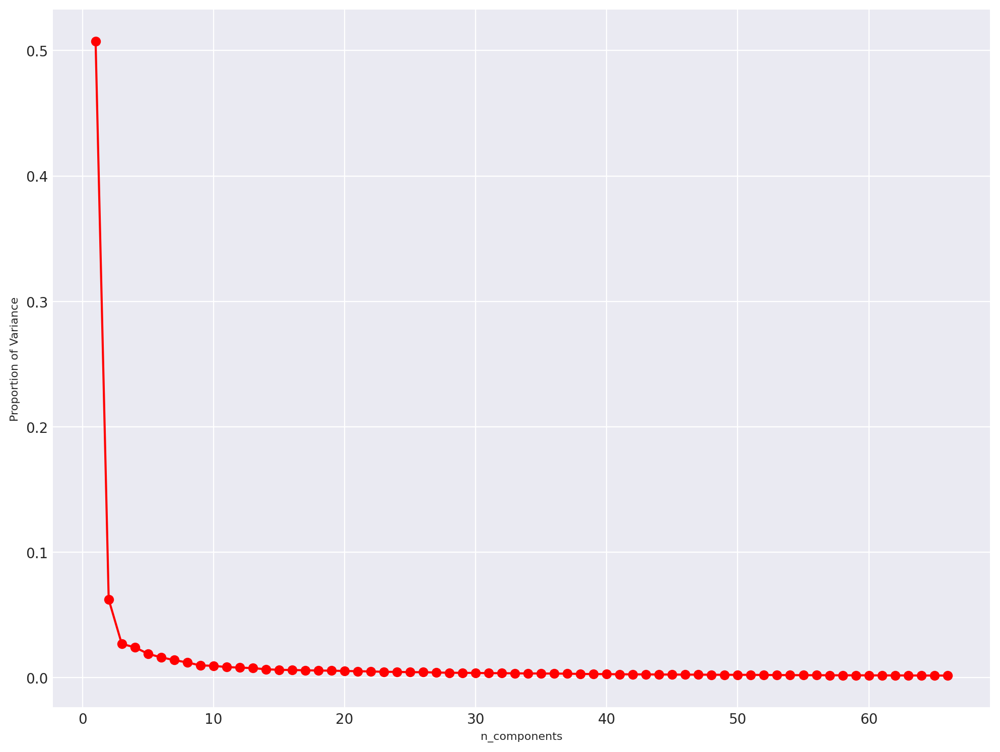

In [ ]:
PC_numbers = np.arange(pca.n_components_) + 1

plt.plot(PC_numbers, prop_var, "ro-")
plt.ylabel("Proportion of Variance", fontsize=8)
plt.xlabel("n_components", fontsize=8)
plt.show()

In [ ]:
X_scaled.shape, X_pca.shape

((10299, 561), (10299, 66))

### Задание 1.3 (0.3 баллов)

Визуализируйте данные в проекции на первые две главные компоненты. Используйте ```cmap="virdis"``` или любой другой, с которым будет красиво :)

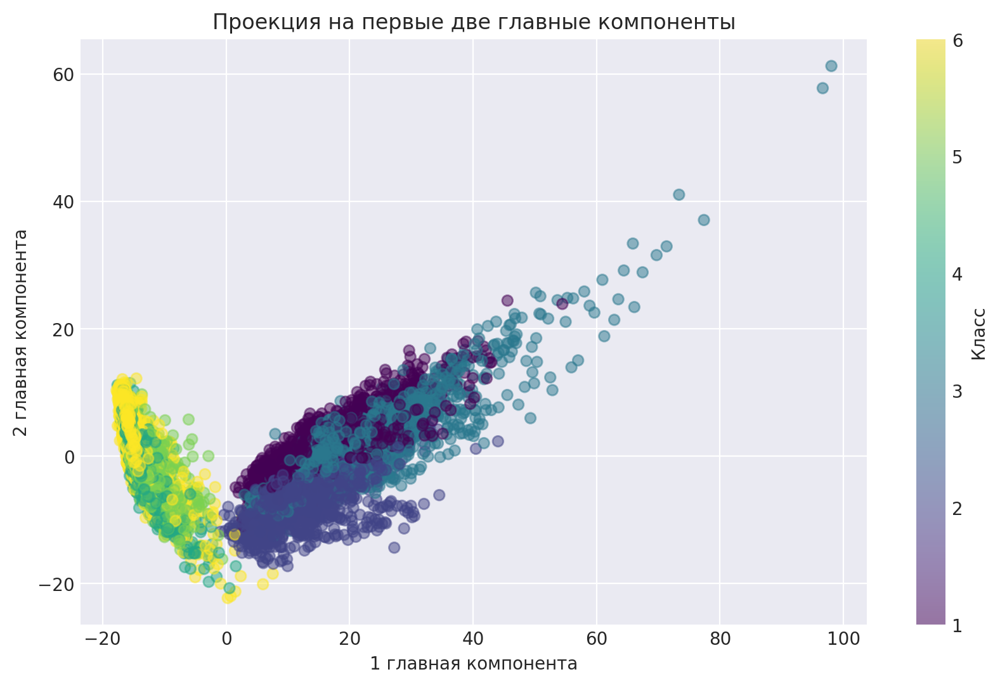

In [ ]:
# your code here
plt.figure(figsize=(10, 6))
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=y.values.ravel(), cmap="viridis", alpha=0.5)
plt.title("Проекция на первые две главные компоненты")
plt.xlabel("1 главная компонента")
plt.ylabel("2 главная компонента")
plt.colorbar(label="Класс")
plt.show()

### Задание 1.4 (0.4 балла)

Сделайте кластеризацию данных методом ```KMeans```, обучив модель на данных со сниженной за счет ```PCA```
размерностью. В данном случае нужно искать 6 кластеров (изначально у нас 6 классов). Засеките время обучения и время инференса.

Параметры:

```n_clusters = 6``` (число уникальных меток целевого класса = 6)

```n_init = 100```

```random_state = RANDOM_STATE``` (для воспроизводимости результата, не забывайте указывать его и дальше!)

[Документация](https://scikit-learn.org/stable/modules/generated/sklearn.cluster.KMeans.html)

In [ ]:
from sklearn.cluster import KMeans

In [ ]:
# your code here
%%time
kmeans = KMeans(n_clusters=6, n_init=100, random_state=RANDOM_STATE)
kmeans.fit(X_pca)
print(
    kmeans.labels_
)  # список из номеров кластеров для каждого объекта обучающей выборки

[5 5 5 ... 3 3 3]
CPU times: user 27.6 s, sys: 7.98 s, total: 35.6 s
Wall time: 23.7 s


In [ ]:
print(f"Число кластеров для KMeans: {len(set(kmeans.labels_))}")

Число кластеров для KMeans: 6


### Задание 1.5 (0.2 балла)

Визуализируйте данные в проекции на первые две главные компоненты. Раскрасьте точки в соответствии с полученными метками кластеров.

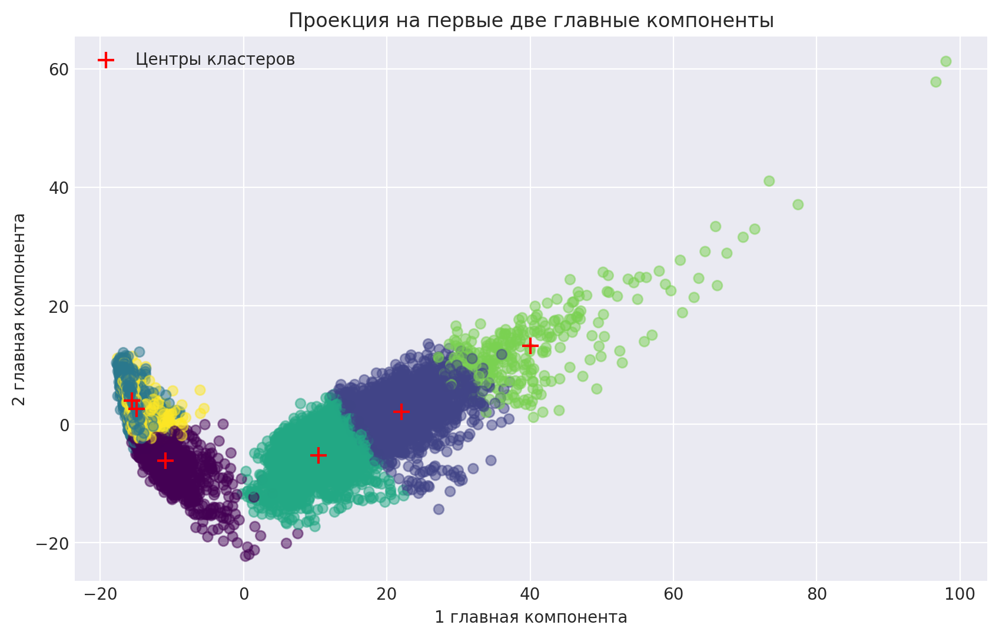

In [ ]:
plt.figure(figsize=(10, 6))
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=kmeans.labels_, cmap="viridis", alpha=0.5)
plt.scatter(
    kmeans.cluster_centers_[:, 0],
    kmeans.cluster_centers_[:, 1],
    marker="+",
    s=100,
    c="red",
    label="Центры кластеров",
)
plt.title("Проекция на первые две главные компоненты")
plt.xlabel("1 главная компонента")
plt.ylabel("2 главная компонента")
# plt.colorbar(label='Кластер')
plt.legend()
plt.show()

### Задание 1.6 (0.3 баллов)

Выберите какие-то метрики (минимум две) из известных вам или из методички (ссылка в начале дз, пункт 2.3.10), объясните ваш выбор.

Выведите на экран значения метрик качества кластеризации и используйте их далее.

Попробуем единственную внутреннюю метрику в sklearn **Силуэт (Silhouette Coefficient)**, без использования истинных меток класса:
- Более высокий показатель Silhouette Coefficient связан с моделью с более четко определенными кластерами. Значения силуэта ограничены между -1 для неправильной кластеризации и +1 для очень плотной кластеризации, и он выше, когда кластеры плотные и хорошо разделены.

In [ ]:
# your code here
from sklearn.metrics import silhouette_score

silhouette = silhouette_score(X_pca, kmeans.labels_)

print("Силуэт:", silhouette)

Силуэт: 0.14073095036998579


Попробуем внешнюю метрику **Adjusted Rand Index (ARI)**:
- ARI близкая к 1 - кластеризация практически совпадает с разбиением на классы;
- ARI≈0 - кластеризация и классификация не связаны;
- ARI<0 - разбиения на классы и кластеры не похожи.

In [ ]:
from sklearn.metrics import adjusted_rand_score

ari = adjusted_rand_score(y.values.ravel(), kmeans.labels_)

print("Adjusted Rand Index (ARI):", ari)

Adjusted Rand Index (ARI): 0.4218753653040152


Метрика **Adjusted Mutual Information (AMI)**:
- Взаимная информация показывает, какую информацию разбиение на кластеры несет о разбиении на классы. Чем больше значение MI (взаимной информации), тем больше разбиение на кластеры похоже на разбиение на классы;
- Чем ближе к 1 значение метрики, тем более похожи разбиения на кластеры и на классы.

In [ ]:
from sklearn.metrics import adjusted_mutual_info_score

ami = adjusted_mutual_info_score(y.values.ravel(), kmeans.labels_)

print("Adjusted Mutual Information (AMI):", ami)

Adjusted Mutual Information (AMI): 0.5618101921634233


Метрика **Гомогенность, полнота и V-мера**:
- Гомогенность показывает, насколько каждый кластер однороден (то есть состоит из объектов одного класса);
- Полнота показывает, насколько объекты одного класса относятся к одному кластеру;
- V-мера - способ учесть оба показателя. Она показывает, насколько результат кластеризации похож на результат разбиения на классы
[https://stepik.org/lesson/806495/step/4?unit=809671](https://stepik.org/lesson/806495/step/4?unit=809671).

In [ ]:
from sklearn.metrics import homogeneity_completeness_v_measure

h, c, v = homogeneity_completeness_v_measure(y.values.ravel(), kmeans.labels_)

# Выводим значения на экран
print("Homogeneity:", h)
print("Completeness:", c)
print("V-measure:", v)

Homogeneity: 0.5427575519917276
Completeness: 0.5829131716628216
V-measure: 0.5621191338232565


Выбор используемых метрик обусловлен тем, что они обеспечивают различные аспекты оценки качества кластеризации. Силуэт оценивает компактность и разделенность кластеров, в то время как ARI оценивает сходство кластеризации с истинными метками классов.

Полученные значения метрик для заданного примера:

- Силуэт: 0.14;
- Adjusted Rand Index (ARI): 0.42;
- Adjusted Mutual Information (AMI): 0.56;
- V-measure: 0.56.

Эти значения показывают, что кластеризация имеет некоторое сходство с истинными метками классов, но силуэт сравнительно низкий, что может указывать на наличие перекрывающихся кластеров или некоторую неоднородность кластеров.

# your text here

### Задание 1.7 (0.8 баллов)
Теперь попробуем сделать кластеризацию с помощью ```AgglomerativeClustering```.

Вновь визуализируйте данные с раскраской по полученным меткам и выведите метрики. Засеките время обучения и время инференса. Сравните с ```KMeans```.

Ответьте на следующие вопросы:
* Стало ли лучше?
* Почему?

[Документация](https://scikit-learn.org/stable/modules/generated/sklearn.cluster.AgglomerativeClustering.html)

In [ ]:
from sklearn.cluster import AgglomerativeClustering

In [ ]:
%%time
agglomerative_clustering = AgglomerativeClustering(n_clusters=6)

agglomerative_clustering.fit(X_pca)

CPU times: user 8.56 s, sys: 623 ms, total: 9.18 s
Wall time: 12.7 s


AgglomerativeClustering(n_clusters=6)

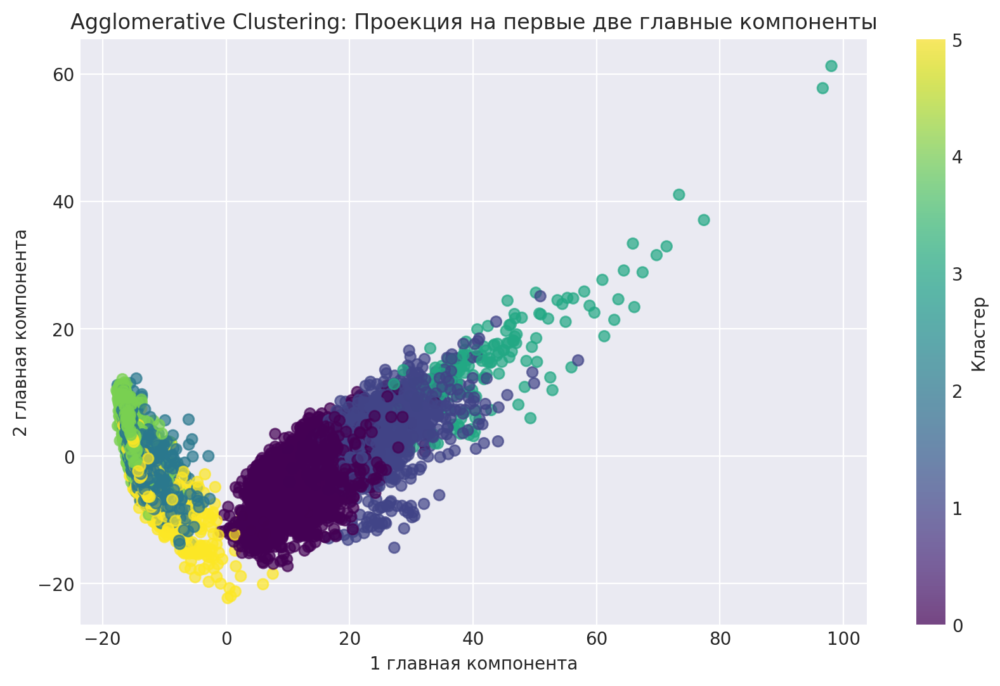

In [ ]:
plt.figure(figsize=(10, 6))
plt.scatter(
    X_pca[:, 0],
    X_pca[:, 1],
    c=agglomerative_clustering.labels_,
    cmap="viridis",
    alpha=0.7,
)
plt.title("Agglomerative Clustering: Проекция на первые две главные компоненты")
plt.xlabel("1 главная компонента")
plt.ylabel("2 главная компонента")
plt.colorbar(label="Кластер")
plt.legend()
plt.show()

In [ ]:
silhouette_agglomerative = silhouette_score(X_pca, agglomerative_clustering.labels_)
ari_agglomerative = adjusted_rand_score(
    y.values.ravel(), agglomerative_clustering.labels_
)
ami_agglomerative = adjusted_mutual_info_score(
    y.values.ravel(), agglomerative_clustering.labels_
)
_, _, v = homogeneity_completeness_v_measure(
    y.values.ravel(), agglomerative_clustering.labels_
)

print("Agglomerative Clustering:")
print("Silhouette Score:", silhouette_agglomerative)
print("Adjusted Rand Index (ARI):", ari_agglomerative)
print("Adjusted Mutual Information (AMI):", ami_agglomerative)
print("V-measure:", v)

Agglomerative Clustering:
Silhouette Score: 0.1507902884195069
Adjusted Rand Index (ARI): 0.45467435572728565
Adjusted Mutual Information (AMI): 0.5942027454504323
V-measure: 0.5944995205273602


In [ ]:
print(
    f"Число кластеров для Agglomerative Clustering: {len(set(agglomerative_clustering.labels_))}"
)

Число кластеров для Agglomerative Clustering: 6


Метрики качества кластеризации для **Agglomerative Clustering** следующие:

- Silhouette Score: 0.1507902884195069;
- Adjusted Rand Index (ARI): 0.45467435572728565;
- Adjusted Mutual Information (AMI): 0.5942027454504323;
- V-measure: 0.5944995205273602.

Сравнивая результаты с кластеризацией, выполненной с помощью **KMeans**, мы видим некоторое улучшение во всех метриках качества кластеризации для Agglomerative Clustering. Это может быть связано с тем, что Agglomerative Clustering использует иерархический подход к кластеризации, который может быть более гибким и способным к обнаружению более сложных структур в данных. Кроме того, он может обнаруживать кластеры различных форм и размеров.

Agglomerative Clustering:
- строит иерархию кластеров;
- может работать без задания числа кластеров заранее;
- обнаруживает кластеры различных форм и размеров, для сложных структур данных.

# your text here

### Задание 1.8 (0.8 баллов)

Попробуйте применить другие методы кластеризации из sklearn.  Засеките время обучения и время инференса. Также вычислите метрики качества, визуализируйте результаты, после чего сделайте вывод о том, какой метод сработал лучше.

**DBSCAN**

In [ ]:
from sklearn.cluster import DBSCAN
from tqdm import tqdm

eps: 10.0
Silhouette Score: -0.11437141704475551
Adjusted Rand Index (ARI): 0.2581442353921525
Adjusted Mutual Information (AMI): 0.24316917757102324
V-measure: 0.3951790360026553
--------------------------
eps: 10.375
Silhouette Score: -0.11765444246356625
Adjusted Rand Index (ARI): 0.26964409657761024
Adjusted Mutual Information (AMI): 0.26975915064239026
V-measure: 0.4057373534326732
--------------------------
eps: 10.75
Silhouette Score: -0.11639437535571456
Adjusted Rand Index (ARI): 0.2876901975626677
Adjusted Mutual Information (AMI): 0.29155988980709335
V-measure: 0.41624318329514787
--------------------------
eps: 11.125
Silhouette Score: -0.11214803408808031
Adjusted Rand Index (ARI): 0.29867507700344614
Adjusted Mutual Information (AMI): 0.31301524676205505
V-measure: 0.4261145503908037
--------------------------
eps: 11.5
Silhouette Score: -0.09385405322593855
Adjusted Rand Index (ARI): 0.30233394665380314
Adjusted Mutual Information (AMI): 0.329088498185679
V-measure: 0.43

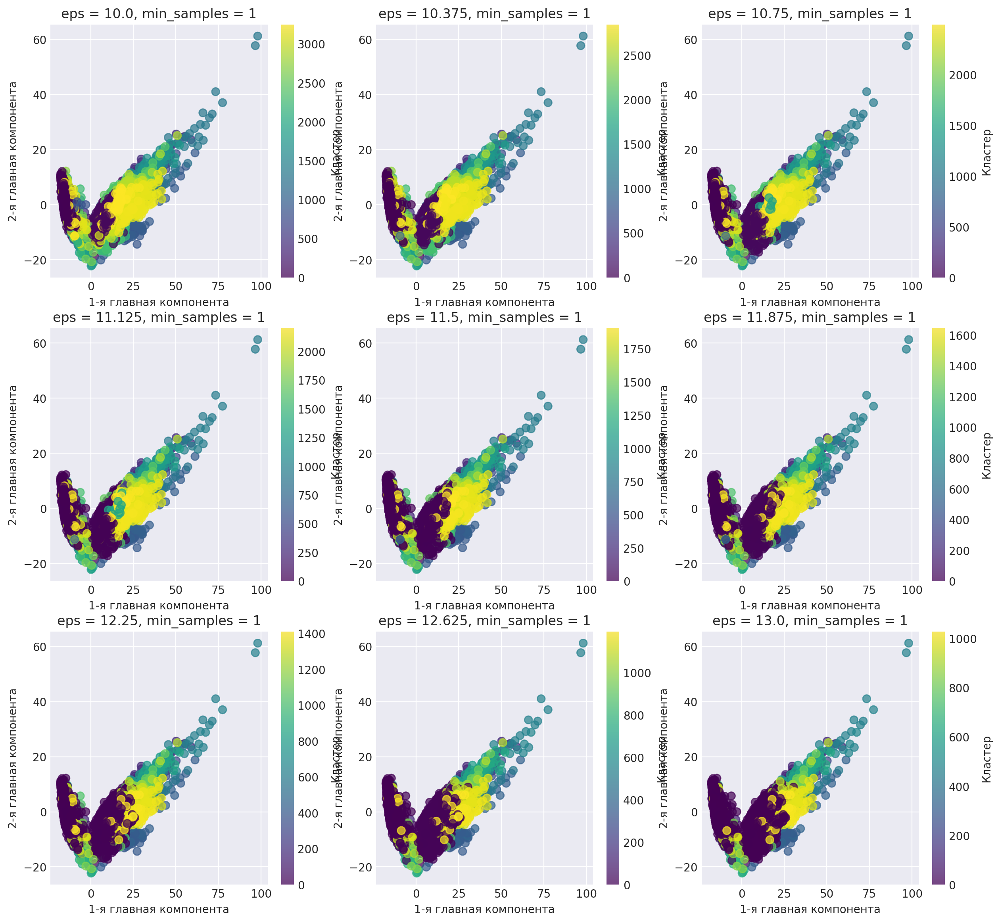

CPU times: user 39 s, sys: 6.67 s, total: 45.6 s
Wall time: 38.1 s


In [ ]:
%%time
plt.figure(figsize=(15, 29))

i = 1
for samples in [1]:
    for e in np.linspace(10, 13, 9):
        dbscan = DBSCAN(eps=e, min_samples=samples)
        clusters = dbscan.fit_predict(X_pca)

        plt.subplot(6, 3, i)
        plt.scatter(
            X_pca[:, 0], X_pca[:, 1], c=clusters, cmap="viridis", s=50, alpha=0.7
        )
        plt.title("eps = {}, min_samples = {}".format(e, samples))
        plt.xlabel("1-я главная компонента")
        plt.ylabel("2-я главная компонента")
        plt.colorbar(label="Кластер")

        try:
            silhouette = silhouette_score(X_pca, clusters)
            ari = adjusted_rand_score(y.values.ravel(), clusters)
            ami = adjusted_mutual_info_score(y.values.ravel(), clusters)
            _, _, v = homogeneity_completeness_v_measure(y.values.ravel(), clusters)

            print("eps:", e)
            print("Silhouette Score:", silhouette)
            print("Adjusted Rand Index (ARI):", ari)
            print("Adjusted Mutual Information (AMI):", ami)
            print("V-measure:", v)
            print("--------------------------")

        except ValueError:
            print("eps = {}, min_samples = {}, score: {}".format(e, samples, -1))

        i += 1

    i += 1

plt.show()

In [ ]:
%%time
dbscan = DBSCAN(eps=12.625, min_samples=1)
cluster_labels = dbscan.fit_predict(X_pca)

CPU times: user 1.42 s, sys: 22.6 ms, total: 1.44 s
Wall time: 1.07 s


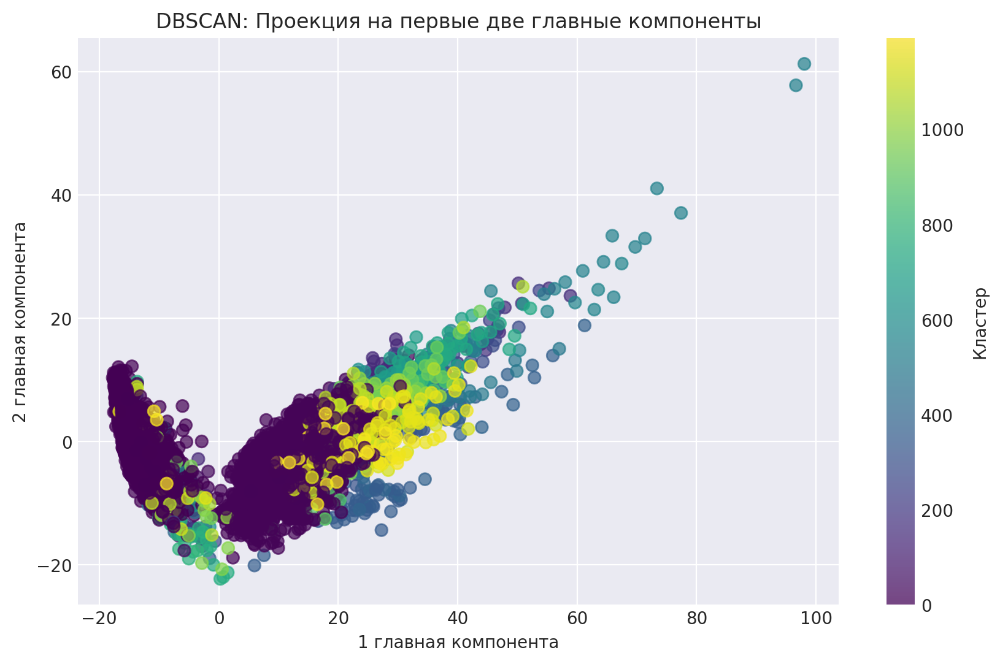

In [ ]:
plt.figure(figsize=(10, 6))
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=cluster_labels, cmap="viridis", s=50, alpha=0.7)
plt.title("DBSCAN: Проекция на первые две главные компоненты")
plt.xlabel("1 главная компонента")
plt.ylabel("2 главная компонента")
plt.colorbar(label="Кластер")
plt.show()

In [ ]:
silhouette_dbscan = silhouette_score(X_pca, cluster_labels)
ari_dbscan = adjusted_rand_score(y.values.ravel(), cluster_labels)
ami_dbscan = adjusted_mutual_info_score(y.values.ravel(), cluster_labels)
_, _, v = homogeneity_completeness_v_measure(y.values.ravel(), cluster_labels)

print("DBSCAN:")
print("Silhouette Score:", silhouette_dbscan)
print("Adjusted Rand Index (ARI):", ari_dbscan)
print("Adjusted Mutual Information (AMI):", ami_dbscan)
print("V-measure:", v)

DBSCAN:
Silhouette Score: -0.04794285666177854
Adjusted Rand Index (ARI): 0.31598157578145136
Adjusted Mutual Information (AMI): 0.3894175375628692
V-measure: 0.4588734440000848


In [ ]:
print(
    f"Число кластеров для DBSCAN c наилучшими гиперпараметрами: {len(set(cluster_labels))}"
)

Число кластеров для DBSCAN c наилучшими гиперпараметрами: 1193


_HDBSCAN_

* https://towardsdatascience.com/a-gentle-introduction-to-hdbscan-and-density-based-clustering-5fd79329c1e8

* https://pberba.github.io/stats/2020/01/17/hdbscan/

In [ ]:
!pip install hdbscan > None

In [ ]:
import hdbscan

min_cluster_size = 6, min_samples = 11
Silhouette Score: 0.2125123483686309
Adjusted Rand Index (ARI): 0.2937974616660244
Adjusted Mutual Information (AMI): 0.439016759822932
V-measure: 0.43964197412930395
--------------------------
min_cluster_size = 6, min_samples = 12
Silhouette Score: 0.2281386085302276
Adjusted Rand Index (ARI): 0.29172638356037695
Adjusted Mutual Information (AMI): 0.4374745121703273
V-measure: 0.43799151590565366
--------------------------
min_cluster_size = 6, min_samples = 13
Silhouette Score: 0.22404159011564953
Adjusted Rand Index (ARI): 0.2894608954411401
Adjusted Mutual Information (AMI): 0.4353216482923174
V-measure: 0.4358450328355229
--------------------------
min_cluster_size = 7, min_samples = 11
Silhouette Score: 0.2125123483686309
Adjusted Rand Index (ARI): 0.2937974616660244
Adjusted Mutual Information (AMI): 0.439016759822932
V-measure: 0.43964197412930395
--------------------------
min_cluster_size = 7, min_samples = 12
Silhouette Score: 0.228138

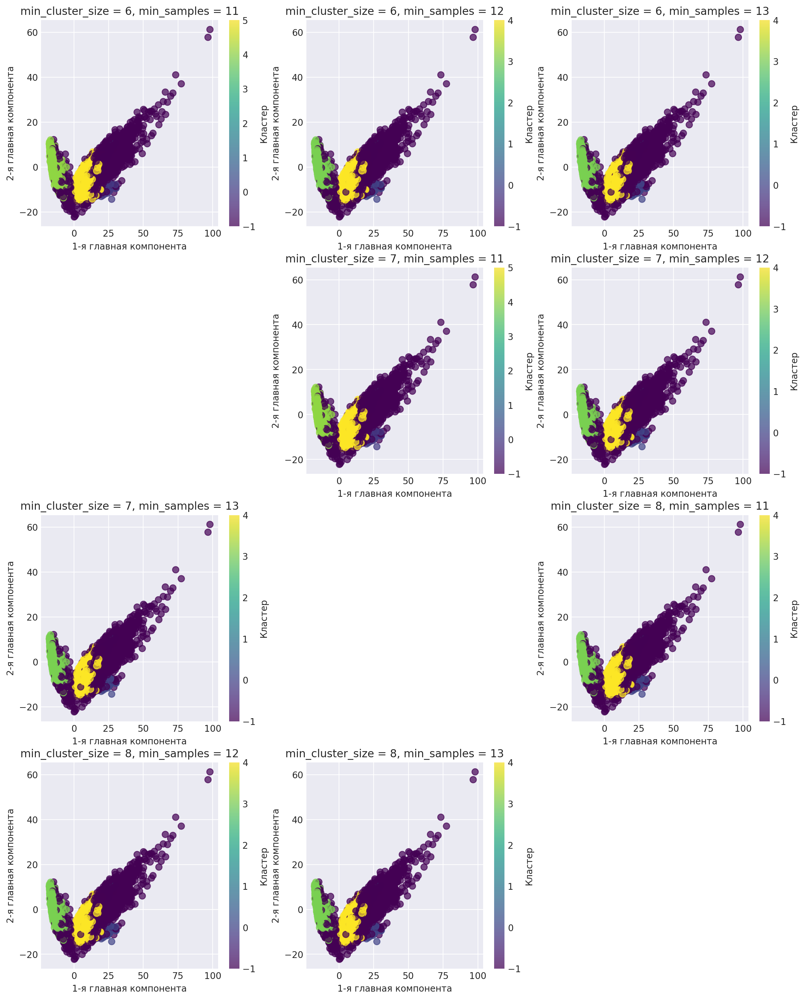

CPU times: user 2min 11s, sys: 5.36 s, total: 2min 17s
Wall time: 2min 30s


In [ ]:
%%time
plt.figure(figsize=(15, 29))

i = 1
for min_cluster_size in [6, 7, 8]:
    for min_samples in [11, 12, 13]:

        hdbscan_model = hdbscan.HDBSCAN(
            min_cluster_size=min_cluster_size, min_samples=min_samples
        )
        clusters = hdbscan_model.fit_predict(X_pca)

        plt.subplot(6, 3, i)
        plt.scatter(
            X_pca[:, 0], X_pca[:, 1], c=clusters, cmap="viridis", s=50, alpha=0.7
        )
        plt.title(
            "min_cluster_size = {}, min_samples = {}".format(
                min_cluster_size, min_samples
            )
        )
        plt.xlabel("1-я главная компонента")
        plt.ylabel("2-я главная компонента")
        plt.colorbar(label="Кластер")

        try:
            silhouette = silhouette_score(X_pca, clusters)
            ari = adjusted_rand_score(y.values.ravel(), clusters)
            ami = adjusted_mutual_info_score(y.values.ravel(), clusters)
            _, _, v = homogeneity_completeness_v_measure(y.values.ravel(), clusters)

            print(f"min_cluster_size = {min_cluster_size}, min_samples = {min_samples}")
            print("Silhouette Score:", silhouette)
            print("Adjusted Rand Index (ARI):", ari)
            print("Adjusted Mutual Information (AMI):", ami)
            print("V-measure:", v)
            print("--------------------------")

        except ValueError:
            print(
                "eps = {}, min_samples = {}, score: {}".format(
                    min_cluster_size, min_samples, -1
                )
            )

        i += 1

    i += 1

plt.show()

In [ ]:
%%time
clusterer = hdbscan.HDBSCAN(min_cluster_size=8)
cluster_labels = clusterer.fit(X_pca)

CPU times: user 13 s, sys: 97.2 ms, total: 13.1 s
Wall time: 18.4 s


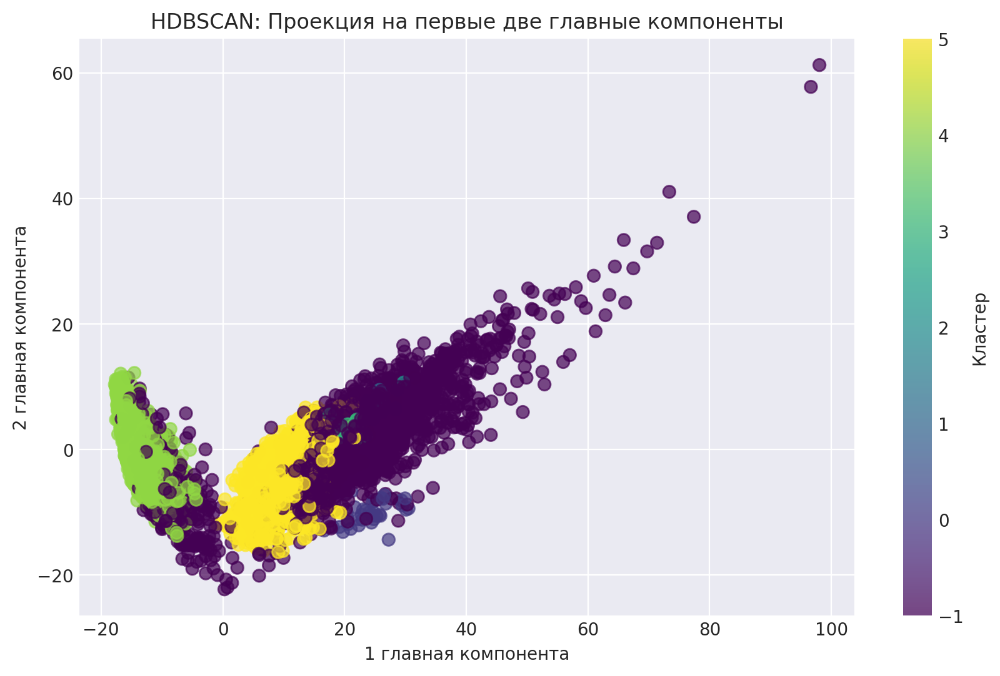

In [ ]:
plt.figure(figsize=(10, 6))
plt.scatter(
    X_pca[:, 0], X_pca[:, 1], c=cluster_labels.labels_, cmap="viridis", s=50, alpha=0.7
)
plt.title("HDBSCAN: Проекция на первые две главные компоненты")
plt.xlabel("1 главная компонента")
plt.ylabel("2 главная компонента")
plt.colorbar(label="Кластер")
plt.show()

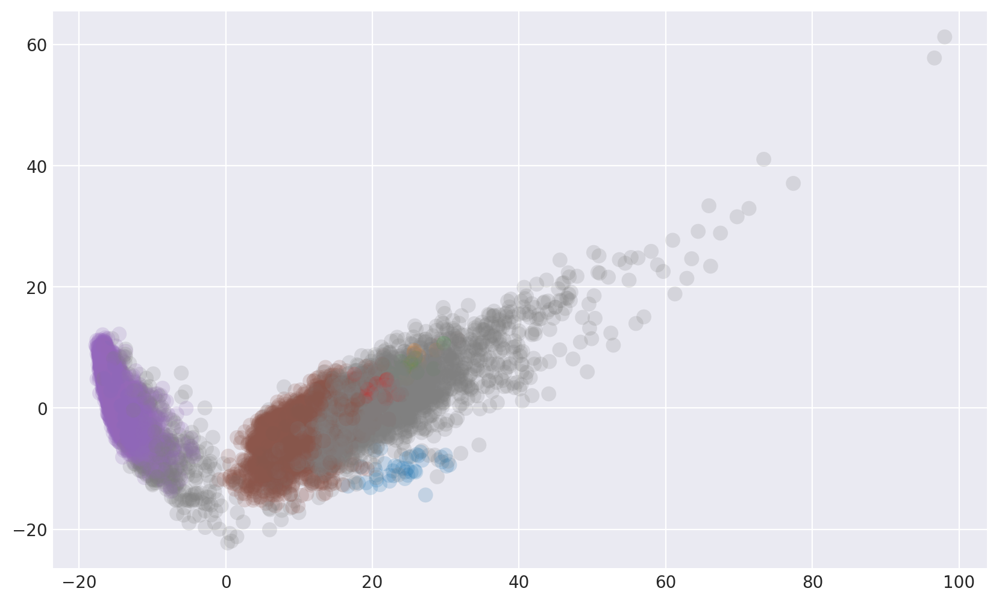

In [ ]:
plt.figure(figsize=(10, 6))

plot_kwds = {"alpha": 0.2, "s": 80, "linewidths": 0}
palette = sns.color_palette()
cluster_colors = [
    sns.desaturate(palette[col], sat) if col >= 0 else (0.5, 0.5, 0.5)
    for col, sat in zip(cluster_labels.labels_, cluster_labels.probabilities_)
]

plt.scatter(X_pca.T[0], X_pca.T[1], c=cluster_colors, **plot_kwds)

In [ ]:
silhouette_hdbscan = silhouette_score(X_pca, cluster_labels.labels_)
ari_hdbscan = adjusted_rand_score(y.values.ravel(), cluster_labels.labels_)
ami_hdbscan = adjusted_mutual_info_score(y.values.ravel(), cluster_labels.labels_)
_, _, v = homogeneity_completeness_v_measure(y.values.ravel(), cluster_labels.labels_)

print("HDBSCAN:")
print("Silhouette Score:", silhouette_hdbscan)
print("Adjusted Rand Index (ARI):", ari_hdbscan)
print("Adjusted Mutual Information (AMI):", ami_hdbscan)
print("V-measure:", v)

HDBSCAN:
Silhouette Score: 0.2237856169785166
Adjusted Rand Index (ARI): 0.3026350068294301
Adjusted Mutual Information (AMI): 0.4474081678287259
V-measure: 0.4480138909572589


In [ ]:
print(f"Число кластеров для HDBSCAN: {len(set(cluster_labels.labels_))}")

Число кластеров для HDBSCAN: 7


__Спектральная кластеризация__

https://crunchingthedata.com/when-to-use-spectral-clustering/

In [ ]:
from sklearn.cluster import SpectralClustering
from sklearn.metrics import silhouette_score

In [ ]:
%%time
spectral_clustering = SpectralClustering(
    n_clusters=4, affinity="nearest_neighbors", random_state=RANDOM_STATE
)
clusters = spectral_clustering.fit(X_pca)

CPU times: user 22.4 s, sys: 16 s, total: 38.4 s
Wall time: 40.9 s


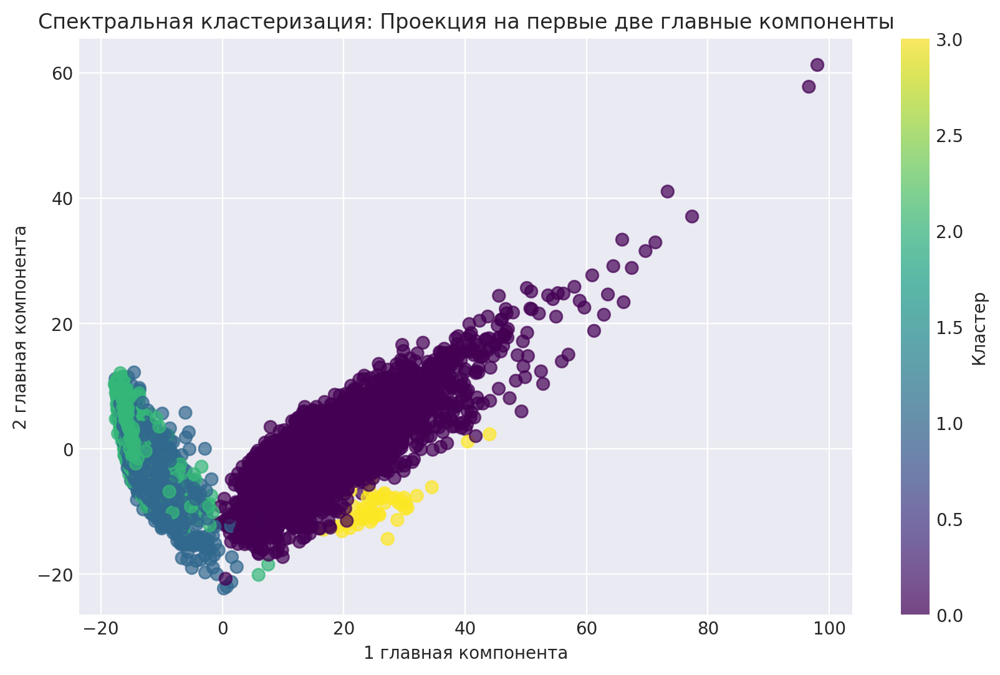

In [ ]:
plt.figure(figsize=(10, 6))
plt.scatter(
    X_pca[:, 0], X_pca[:, 1], c=clusters.labels_, cmap="viridis", s=50, alpha=0.7
)
plt.title("Спектральная кластеризация: Проекция на первые две главные компоненты")
plt.xlabel("1 главная компонента")
plt.ylabel("2 главная компонента")
plt.colorbar(label="Кластер")
plt.show()

In [ ]:
silhouette_spectral = silhouette_score(X_pca, clusters.labels_)
ari_spectral = adjusted_rand_score(y.values.ravel(), clusters.labels_)
ami_spectral = adjusted_mutual_info_score(y.values.ravel(), clusters.labels_)
_, _, v = homogeneity_completeness_v_measure(y.values.ravel(), clusters.labels_)

print("Спектральная кластеризация:")
print("Silhouette Score:", silhouette_spectral)
print("Adjusted Rand Index (ARI):", ari_spectral)
print("Adjusted Mutual Information (AMI):", ami_spectral)
print("V-measure:", v)

Спектральная кластеризация:
Silhouette Score: 0.18760781255892095
Adjusted Rand Index (ARI): 0.4891246256230199
Adjusted Mutual Information (AMI): 0.6941904561623473
V-measure: 0.6943481179834115


In [ ]:
print(f"Число кластеров для Спектральной кластеризации: {len(set(clusters.labels_))}")

Число кластеров для Спектральной кластеризации: 4


**KMeans**:

- Время обучения: примерно 21.8 секунды
- Метрики качества:
  - Silhouette Score: 0.14073
  - Adjusted Rand Index (ARI): 0.42187
  - Adjusted Mutual Information (AMI): 0.56181
  - V-measure: 0.56211
  - Число кластеров: 6

**AgglomerativeClustering**:

- Время обучения: примерно 8.68 секунды
- Метрики качества:
  - Silhouette Score: 0.15079
  - Adjusted Rand Index (ARI): 0.45467
  - Adjusted Mutual Information (AMI): 0.59420
  - V-measure: 0.59449
  - Число кластеров: 6

**DBSCAN**:

- Время обучения: примерно 1.45 секунды
- Метрики качества:
  - Silhouette Score: -0.04794
  - Adjusted Rand Index (ARI): 0.31598
  - Adjusted Mutual Information (AMI): 0.38942
  - V-measure: 0.45887
  - Число кластеров: 1193

**HDBSCAN**:

- Время обучения: примерно 11.8 секунды
- Метрики качества:
  - Silhouette Score: 0.22379
  - Adjusted Rand Index (ARI): 0.30264
  - Adjusted Mutual Information (AMI): 0.44741
  - V-measure: 0.44801
  - Число кластеров: 7

**Спектральная кластеризация**:

- Время обучения: примерно 18.2 секунды
- Метрики качества:
  - Silhouette Score: 0.18761
  - Adjusted Rand Index (ARI): 0.48912
  - Adjusted Mutual Information (AMI): 0.69419
  - V-measure: 0.69435
  - Число кластеров: 4

В итоге:

- AgglomerativeClustering дает хорошее качество и одно из самых низких времени обучения.

- DBSCAN дал высокое количество кластеров, но его Silhouette Score был отрицательным, что указывает на плохую качественную кластеризацию.

- HDBSCAN сработал лучше DBSCAN с точки зрения метрик качества, но время обучения немного больше. Однако он все еще дал сравнительно небольшое количество кластеров.

- Спектральная кластеризация дала лучшие результаты с точки зрения метрик качества, но время обучения было самым длительным из всех методов.
Если вам важна скорость и вы не против получить большое количество кластеров, то DBSCAN может быть подходящим выбором.

# your text here

### Задание 1.9 (1 балл)
Для самой успешной из полученных кластеризаций попробуйте дать интерпретацию кластеров. Опишите характеристики объектов, попавших в каждый кластер. Для этого можете ответить на следующие вопросы:

* Похожи ли объекты внутри каждого кластера на определенный тип активности человека?
* В каких кластерах смешано несколько типов активности? С чем, на ваш взгляд, это может быть связано?
* Качественная ли получилась кластеризация? На основании чего вы можете сделать такой вывод?

Визуализируем данные при помощи **t-SNE**

In [ ]:
from sklearn.manifold import TSNE

In [ ]:
%%time
tsne = TSNE(random_state=RANDOM_STATE)
X_tsne = tsne.fit_transform(X_pca)

CPU times: user 2min 57s, sys: 218 ms, total: 2min 57s
Wall time: 1min 48s


In [ ]:
tsne_df = pd.DataFrame(np.column_stack((X_tsne, y)), columns=["X", "Y", "Targets"])
tsne_df["Targets"] = tsne_df.Targets.astype(int)

In [ ]:
tsne_df.head(3)

,X,Y,Targets
0,-43.179535,-6.621680,5
1,-33.366226,-19.204466,5
2,-31.399778,-41.603851,5


<Figure size 1000x600 with 0 Axes>

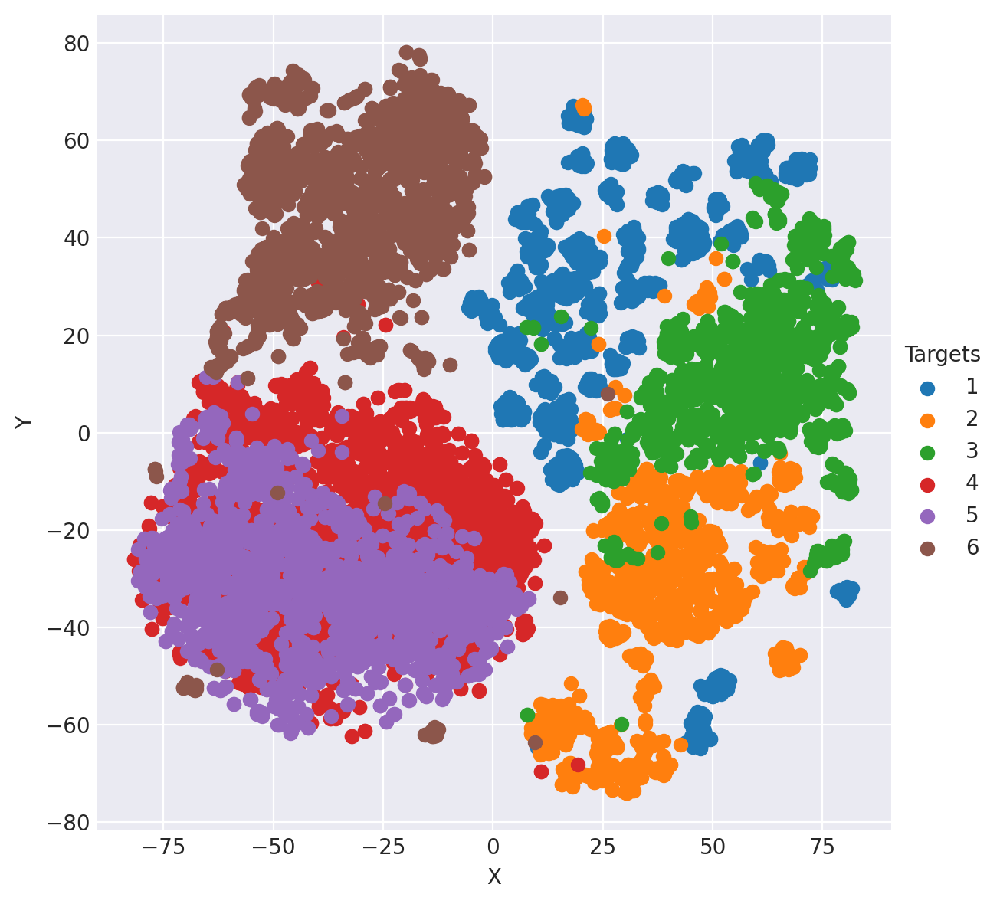

In [ ]:
plt.figure(figsize=(10, 6))
g = sns.FacetGrid(data=tsne_df, hue="Targets", height=6)
g.map(plt.scatter, "X", "Y").add_legend()
plt.show()

Исходные метки:

1 - ходьба, 2 - подъем вверх по лестнице, 3 - спуск по лестнице, 4 - сидение, 5 - стояние, 6 - лежание

Исходя из данных с акселерометров и гироскопов мобильных телефонов Samsung, применение алгоритмов для определения типов движений показывает, что часто возникают путаница между классами 1, 2 и 3, а также между классами 4, 5 и 6. Особенно смешаны активности для классов 4 и 5. Наилучший алгоритм `спектральной кластеризации` четко выделяет кластер 6 и объединяет классы 4 и 5 в один кластер. Он также объединяет классы 1 и 3, при этом немного включая часть класса 2.

Таким образом, алгоритм не различает `сидение и стояние`, а также `ходьбу и спуск по лестнице`, но способен различить `подъем по лестнице` и `лежание`.



# your text here

## Задание 2. Разделение изображения на семантические компоненты (5 баллов)

![RedPanda](http://imgur.com/6Aa52Lm.png)

Алгоритмы кластеризации могут применяться в самых разных задачах. Например, в анализе изображений есть задача разделения изображения на семантические компоненты, которую можно решать в том числе с помощью алгоритмов кластеризации.

Проверим их на ```duck.jpg``` и ```owls.jpg```

### Задание 2.0 (0.1 балл)

Откройте изображения, после чего визуализируйте их с помощью ```plt.imshow()```

In [ ]:
from skimage import io

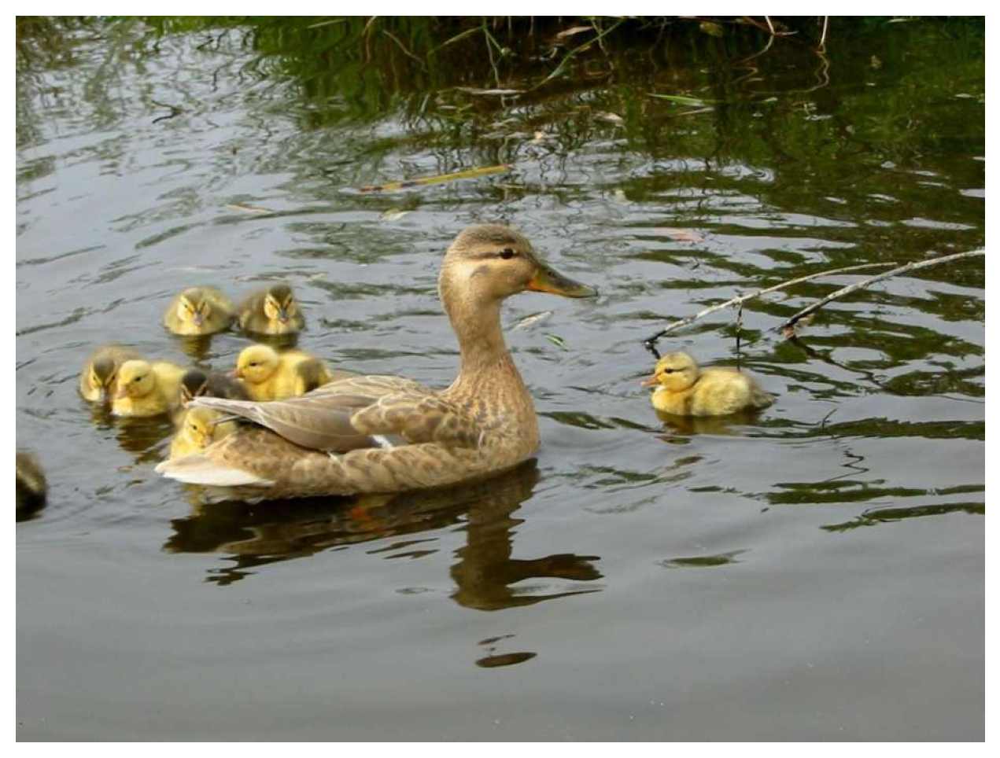

In [ ]:
img_duck = io.imread(f"{PATH_DATA}/Duck.jpg")
img_owls = io.imread(f"{PATH_DATA}/Owls.jpg")

plt.figure(figsize=(10, 6))
plt.axis("off")
plt.imshow(img_duck)

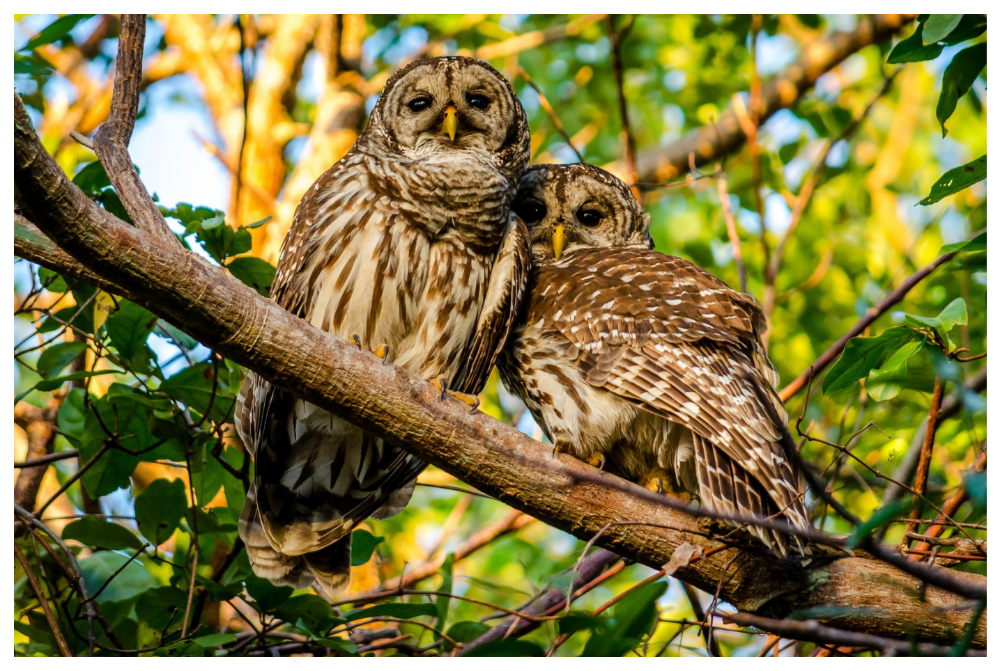

In [ ]:
plt.figure(figsize=(10, 6))
plt.axis("off")
plt.imshow(img_owls)

### Задание 2.1 (1.5 балла)
Для каждого изображения, используя кластеризацию ```KMeans```, выделите компоненты, охарактеризовав каждый пиксель следующим образом: $\psi_i = [\lambda x_i, \lambda y_i, r_i, g_i, b_i]$, где
$x_i$ и $y_i$ — координаты пикселя, $r_i, g_i, b_i$ — его цвет, $\lambda$ — параметр, выражающий важность пространственной связности перед цветовой похожестью.

Примените полученную функцию, взяв следующие $\lambda$: 0.3 и 1.5 для ```duck.jpg``` и ```owls.jpg``` (или другие, но тогда с вас красивые результаты :) )

Число кластеров подберите разумным образом на свой вкус (в качестве нулевого приближения можно взять 3)

**KMeans сегментация**

Подберем минимальное число кластеров, которе визуально не ухудшит качество изображения.

In [ ]:
from sklearn.cluster import MiniBatchKMeans
from scipy.stats import randint

In [ ]:
def find_components(image, lmbd, n_clusters=3):
    """
    Х: каждая строка - пиксель изображения;
    Количество столбцов равно количеству каналов цвета пикселя + 2, чтобы включить координаты пикселя, модифицированные параметром lambda;
    Для каждого пикселя находим пространственные координаты lmbd * i, lmbd * j;
    Добавляем значения цветовых каналов пикселя к списку - создаем вектор признаков для каждого пикселя.
    """
    height, width, channels = image.shape

    X = np.zeros((height * width, channels + 2))

    for i in range(height):
        for j in range(width):
            X[i * width + j] = [lmbd * i, lmbd * j] + list(image[i, j])

    k_means = KMeans(n_clusters=n_clusters, n_init="auto", random_state=RANDOM_STATE)
    k_means.fit(X)

    labels = k_means.labels_

    segmented_image = np.zeros_like(image)

    for i in range(height):
        for j in range(width):
            segmented_image[i, j] = k_means.cluster_centers_[
                labels[i * width + j], 2:
            ]  # усредненный цвет

    return segmented_image

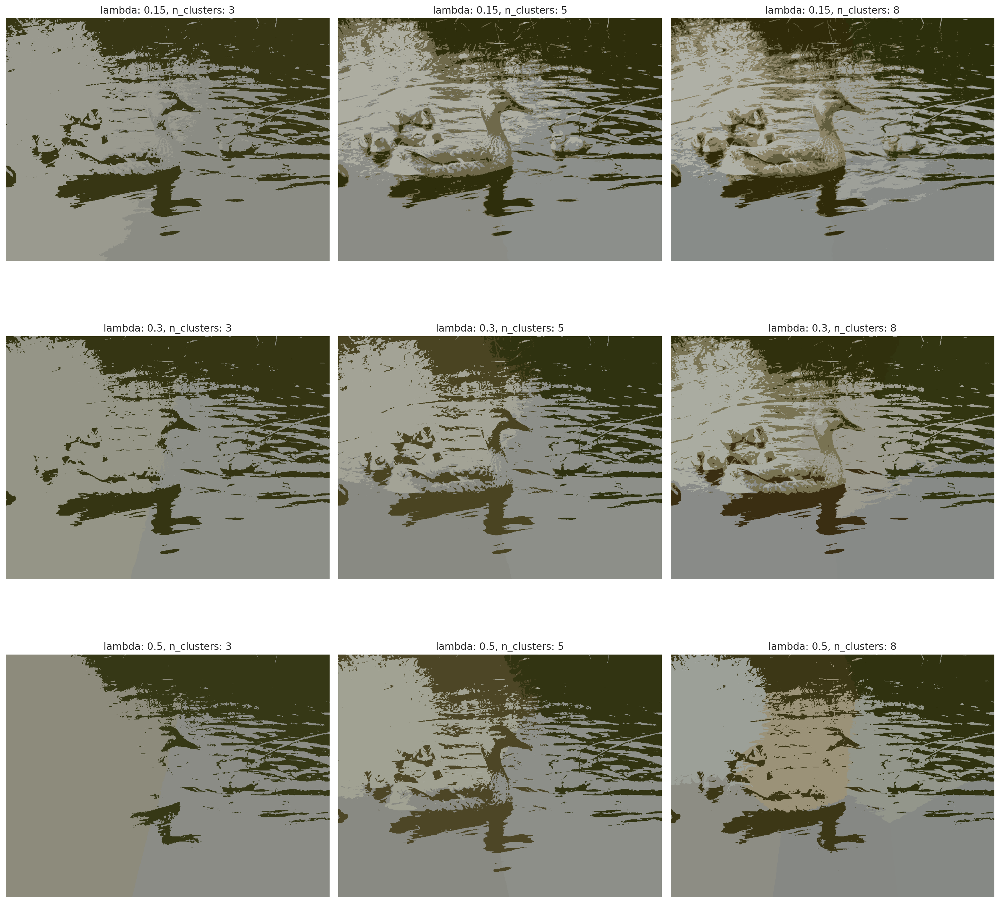

CPU times: user 37.4 s, sys: 1.97 s, total: 39.4 s
Wall time: 35.5 s


In [ ]:
%%time
lambda_values = [0.15, 0.3, 0.5]
n_clusters_list = [3, 5, 8]

plt.figure(figsize=(17, 17))

i = 1
for lambda_value in lambda_values:
    for n_clusters in n_clusters_list:
        segmented_image = find_components(img_duck, lambda_value, n_clusters)

        plt.subplot(3, 3, i)
        plt.imshow(segmented_image)
        plt.title(f"lambda: {lambda_value}, n_clusters: {n_clusters}")
        plt.axis("off")

        i += 1

plt.tight_layout()
plt.show()

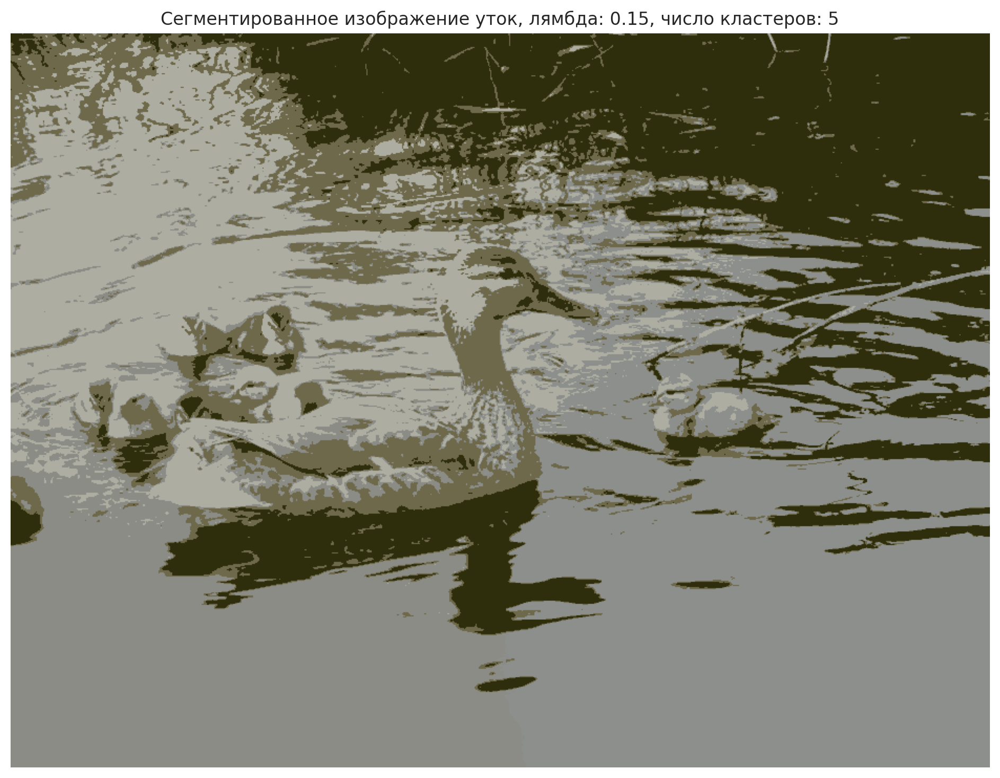

In [ ]:
lambda_value = 0.15
n_clusters = 5

segmented_image = find_components(img_duck, lambda_value, n_clusters)

plt.figure(figsize=(15, 9))
plt.imshow(segmented_image)
plt.title(
    f"Сегментированное изображение уток, лямбда: {lambda_value}, число кластеров: {n_clusters}"
)
plt.axis("off")
plt.show()

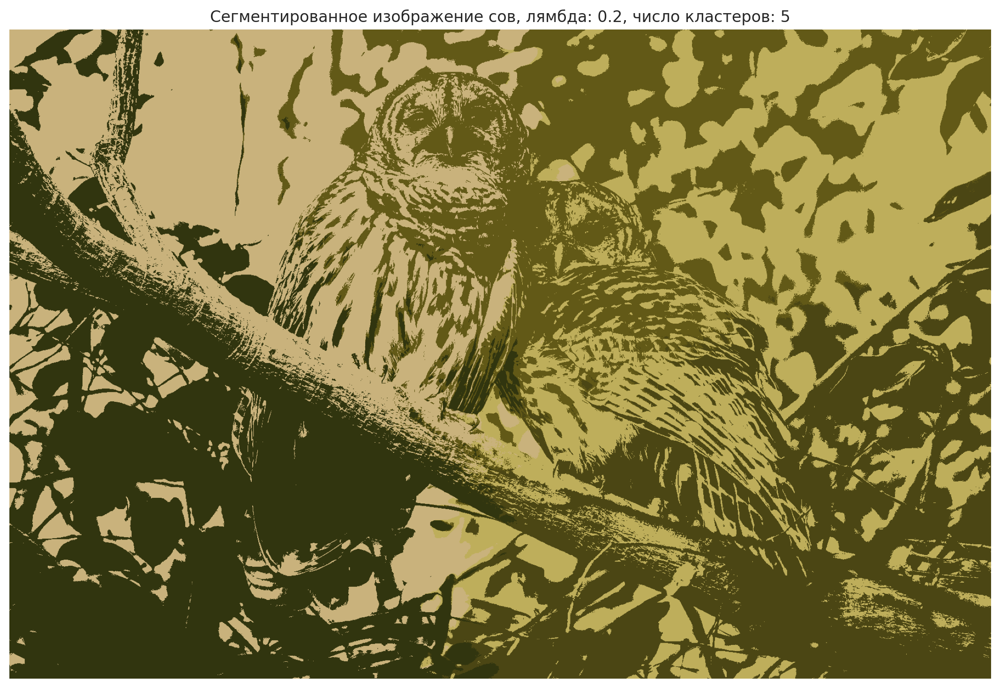

CPU times: user 23.1 s, sys: 852 ms, total: 24 s
Wall time: 19.3 s


In [ ]:
%%time
lambda_value = 0.2
n_clusters = 5

segmented_image = find_components(img_owls, lambda_value, n_clusters)

plt.figure(figsize=(15, 9))
plt.imshow(segmented_image)
plt.title(
    f"Сегментированное изображение сов, лямбда: {lambda_value}, число кластеров: {n_clusters}"
)
plt.axis("off")
plt.show()

### Задание 2.2 (1.5 балла)
Попробуйте выделить сегменты при помощи [спектральной кластеризации](http://scikit-learn.org/stable/modules/clustering.html#spectral-clustering). Обратите внимание на [пример в sklearn](http://scikit-learn.org/0.16/auto_examples/cluster/plot_lena_segmentation.html). Для ускорения работы алгоритма рекомендуется привести изображение к серому цвету. При необходимости можно сжать изображения в 2 раза.

Подсказка: ```skimage``` с его ```color``` и ```transform``` в этом помогут :)

Или же воспользуйтесь аналогичными средствами ```PIL``` или ```cv2```

**Спектральная кластеризация**

In [ ]:
from skimage import color, transform
from sklearn.cluster import spectral_clustering

from sklearn.feature_extraction import image

In [ ]:
def spectral_segmentation(img, n_clusters, beta, eps, assign_labels="kmeans"):
    gray_image = color.rgb2gray(img)

    # Сожмем изображение в 6 раз
    resized_image = transform.resize(
        gray_image, (gray_image.shape[0] // 6, gray_image.shape[1] // 6)
    )

    graph = image.img_to_graph(resized_image)
    graph.data = np.exp(-beta * graph.data / resized_image.std()) + eps

    labels = spectral_clustering(
        graph,
        n_clusters=n_clusters,
        assign_labels=assign_labels,
        random_state=RANDOM_STATE,
    )

    labels = labels.reshape(resized_image.shape)

    return labels, resized_image

### Задание 2.3 (0.9 баллов)
Визуализируйте результаты сегментации (аналогично рисунку в начале задания 2) для обоих методов.

In [ ]:
# img = img_duck
# n_clusters = 7 # Число кластеров
# beta = 5 # Детализрованность огибания кластеров
# eps = 1e-4 # Прямота линий границ
# assign_labels = 'discretize'

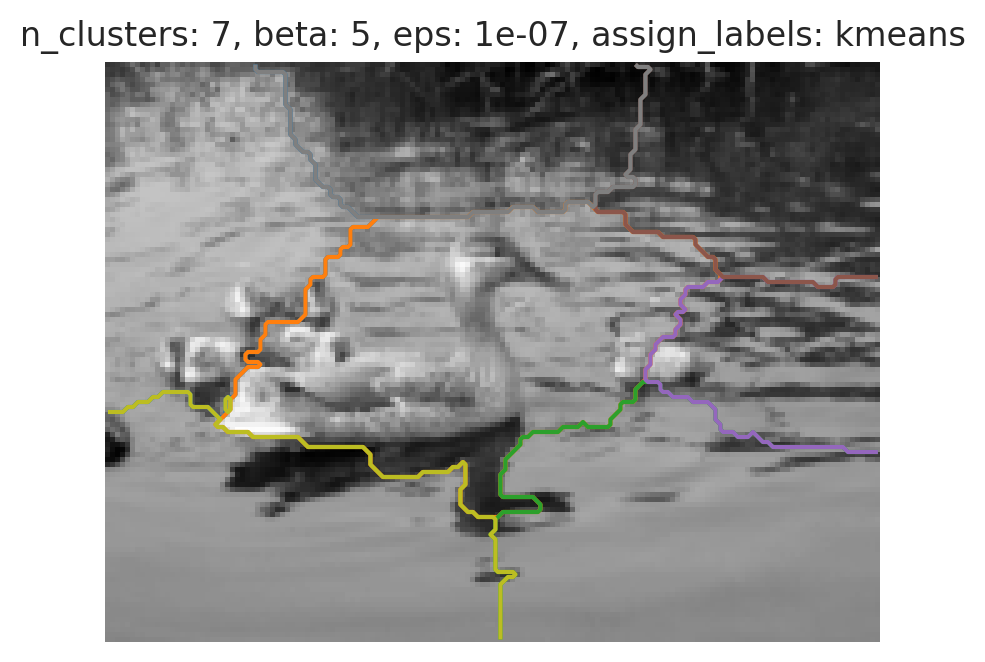

CPU times: user 30 s, sys: 19.6 s, total: 49.6 s
Wall time: 32.6 s


In [ ]:
%%time
img = img_duck
n_clusters = 7  # Число кластеров
beta = 5  # Детализрованность огибания кластеров
eps = 1e-7  # Прямота линий границ
assign_labels = "kmeans"


labels, resized_image = spectral_segmentation(img, n_clusters, beta, eps, assign_labels)

plt.figure(figsize=(5, 5))
plt.imshow(resized_image, cmap=plt.cm.gray)

for l in range(n_clusters):
    plt.contour(
        labels == l,
        colors=[
            plt.cm.tab10(l / float(n_clusters)),
        ],
    )

plt.title(
    f"n_clusters: {n_clusters}, beta: {beta}, eps: {eps}, assign_labels: {assign_labels}"
)
plt.axis("off")
plt.show()

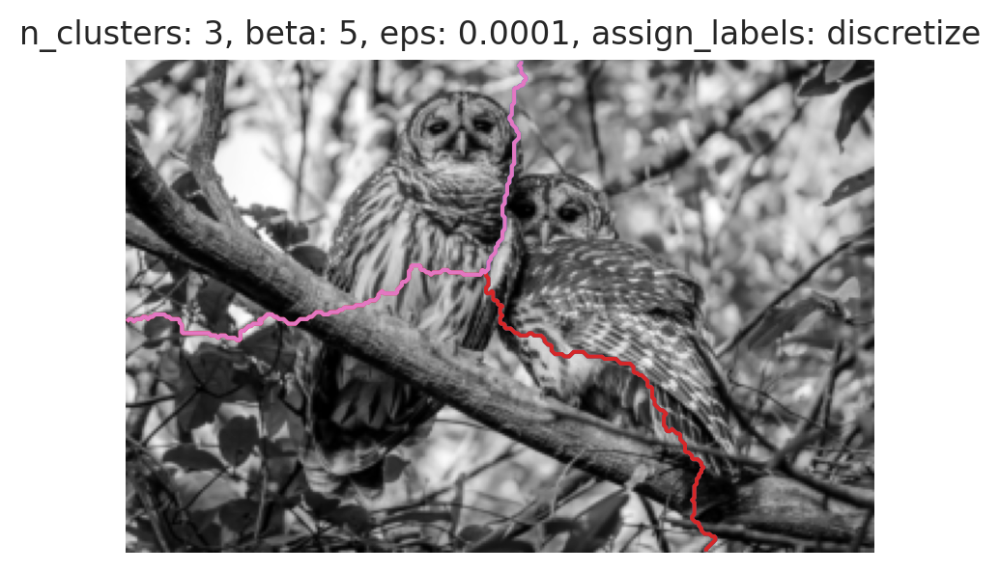

CPU times: user 11min 23s, sys: 7min 39s, total: 19min 3s
Wall time: 11min 9s


In [ ]:
%%time
img = img_owls
n_clusters = 3  # Число кластеров
beta = 5  # Детализрованность огибания кластеров
eps = 1e-4  # Прямота линий границ
assign_labels = "discretize"


labels, resized_image = spectral_segmentation(img, n_clusters, beta, eps, assign_labels)

plt.figure(figsize=(5, 5))
plt.imshow(resized_image, cmap=plt.cm.gray)

for l in range(n_clusters):
    plt.contour(
        labels == l,
        colors=[
            plt.cm.tab10(l / float(n_clusters)),
        ],
    )

plt.title(
    f"n_clusters: {n_clusters}, beta: {beta}, eps: {eps}, assign_labels: {assign_labels}"
)
plt.axis("off")
plt.show()

### Задание 2.4 (1 балл)
Найдите интересную картинку милого животного и примените алгоритмы и к ней. Поэкспериментируйте с параметрами алгоритмов. Картинку нужно будет загрузить вместе с работой. Слишком большие лучше не брать - считаться будет долго. Не забудьте визуализировать!

Сравните два подхода и сегментации, к которым они приводят.
Для всех ли изображений в результате сегментации хорошо видны контуры объектов?

# your text here

Определим признаки качаственной кластеризации:
- Каждый кластер должен иметь четкие границы, обозначающие переходы между различными объектами или текстурами на изображении.
- Пиксели внутри каждого кластера должны быть семантически связанными и иметь схожие характеристики (например, цвет, текстура и т.д.). В примере ниже, все пиксели объекта котенка должны быть отнесены к одному кластеру.
- Мелкие объекты и текстуры должны быть правильно сегментированы (детали изображения должны быть учтены).
- Минимизация влияния шума на результаты сегментации (случайные изменения цвета или яркости).
- Алгоритм должен выдавать схожие результаты на разных изображениях без значительного изменения параметров.

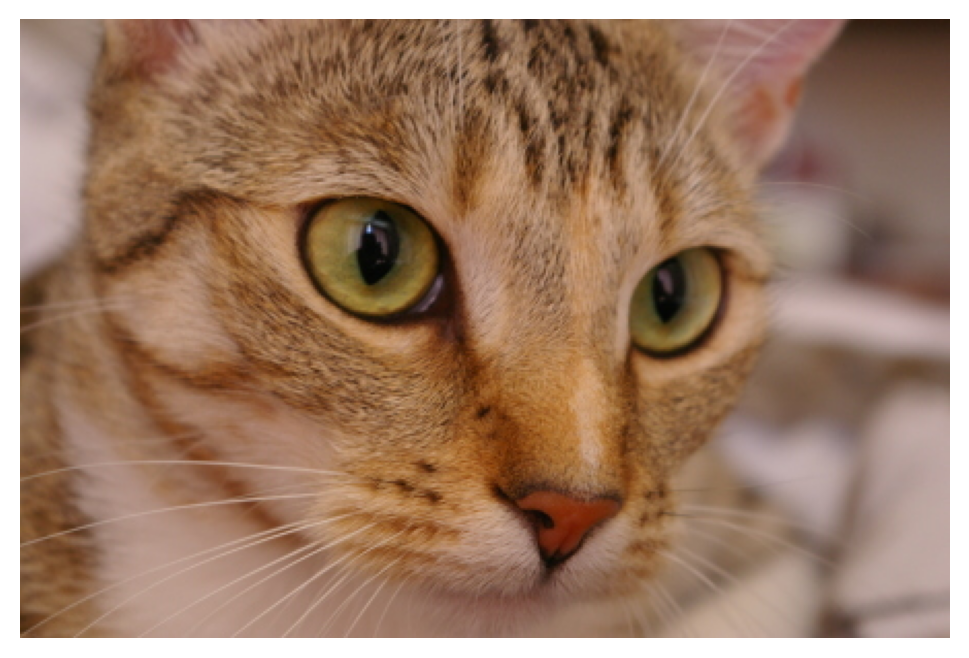

In [ ]:
from skimage import data

# Загрузка изображения котенка из библиотеки skimage
img_kitten = data.chelsea()

# Визуализация изображения
plt.figure(figsize=(6, 6))
plt.imshow(img_kitten)
plt.axis("off")
plt.show()

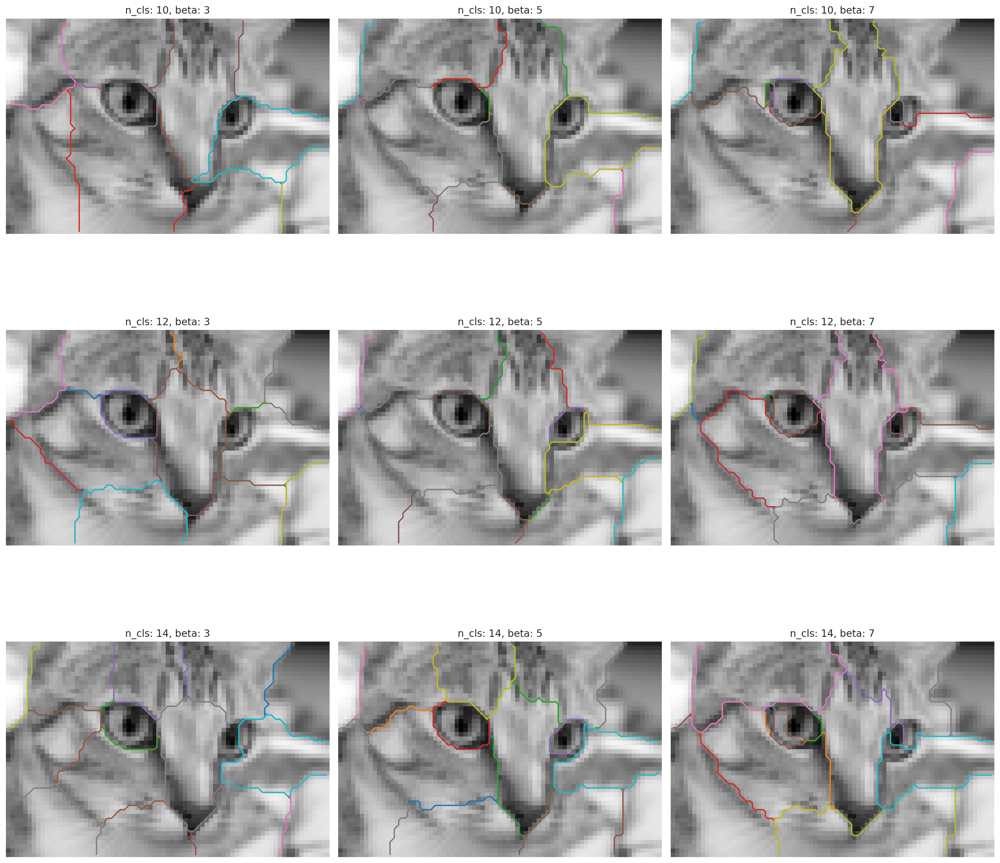

CPU times: user 27.4 s, sys: 16.9 s, total: 44.3 s
Wall time: 27.2 s


In [ ]:
%%time
img = img_kitten
n_clusters = [10, 12, 14]
betas = [3, 5, 7]
eps = 1e-6
assign_labels = "kmeans"

plt.figure(figsize=(17, 17))

i = 1
for n_cluster in n_clusters:
    """
    Подбор отптимальных гиперпараметров
    """
    for beta in betas:
        labels, resized_image = spectral_segmentation(
            img, n_cluster, beta, eps, assign_labels
        )

        plt.subplot(3, 3, i)
        plt.imshow(resized_image, cmap=plt.cm.gray)

        for l in range(n_cluster):
            plt.contour(
                labels == l,
                colors=[
                    plt.cm.tab10(l / float(n_cluster)),
                ],
            )

        plt.title(f"n_cls: {n_cluster}, beta: {beta}")
        plt.axis("off")

        i += 1

plt.tight_layout()
plt.show()

Отметим наиболее оптималные гиперпараметры:
- n_clusters = 13
- beta = 4
- eps = 1e-6
- assign_labels = 'kmeans'

На мой взгляд в данном случае отчетливо сегментируются глаза, носовая часть, часть верхней губы с челюстью, пара лобных частей головы и уши.

Аналогично подберем гиперпараметры для KMeans сегментация

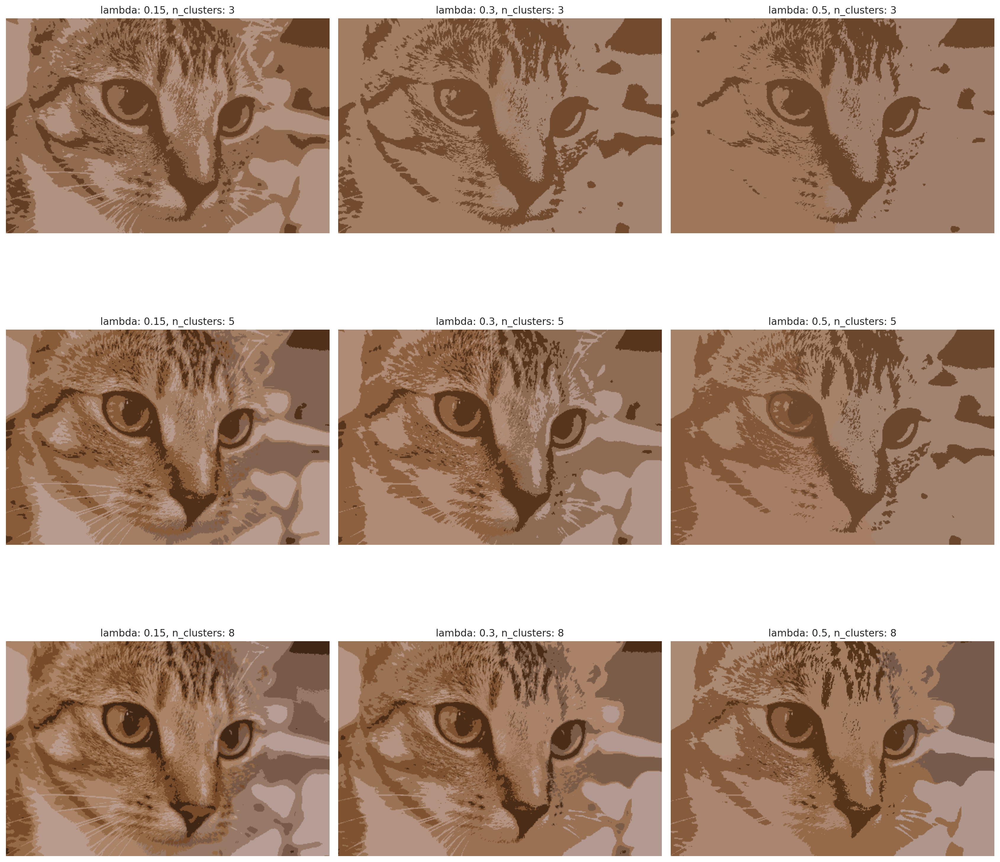

CPU times: user 11.6 s, sys: 1.25 s, total: 12.9 s
Wall time: 11.1 s


In [ ]:
%%time
img = img_kitten
lambda_values = [0.15, 0.3, 0.5]
n_clusters_list = [3, 5, 8]

plt.figure(figsize=(17, 17))

i = 1
for n_clusters in n_clusters_list:
    for lambda_value in lambda_values:
        segmented_image = find_components(img, lambda_value, n_clusters)

        plt.subplot(3, 3, i)
        plt.imshow(segmented_image)
        plt.title(f"lambda: {lambda_value}, n_clusters: {n_clusters}")
        plt.axis("off")

        i += 1

plt.tight_layout()
plt.show()

Отметим наиболее оптималные гиперпараметры:
- n_clusters = 3
- lambda = 0.3

В случае KMeans сегментации так же нам необходимо выделить глаза, носовую часть, челюсть и лобную часть с ушами.

Выведем получившиеся изображения:

__Спектральная кластеризация__

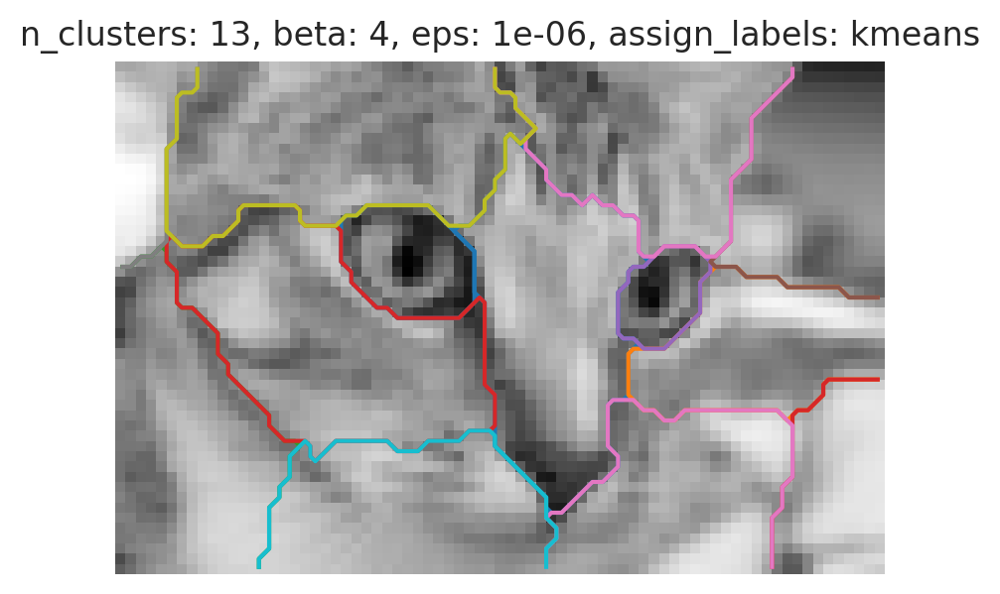

CPU times: user 2.19 s, sys: 1.55 s, total: 3.74 s
Wall time: 2.56 s


In [ ]:
%%time
img = img_kitten
n_clusters = 13  # Число кластеров
beta = 4  # Детализрованность огибания кластеров
eps = 1e-6  # Прямота линий границ
assign_labels = "kmeans"


labels, resized_image = spectral_segmentation(img, n_clusters, beta, eps, assign_labels)

plt.figure(figsize=(5, 5))
plt.imshow(resized_image, cmap=plt.cm.gray)

for l in range(n_clusters):
    plt.contour(
        labels == l,
        colors=[
            plt.cm.tab10(l / float(n_clusters)),
        ],
    )

plt.title(
    f"n_clusters: {n_clusters}, beta: {beta}, eps: {eps}, assign_labels: {assign_labels}"
)
plt.axis("off")
plt.show()

__KMeans сегментация__

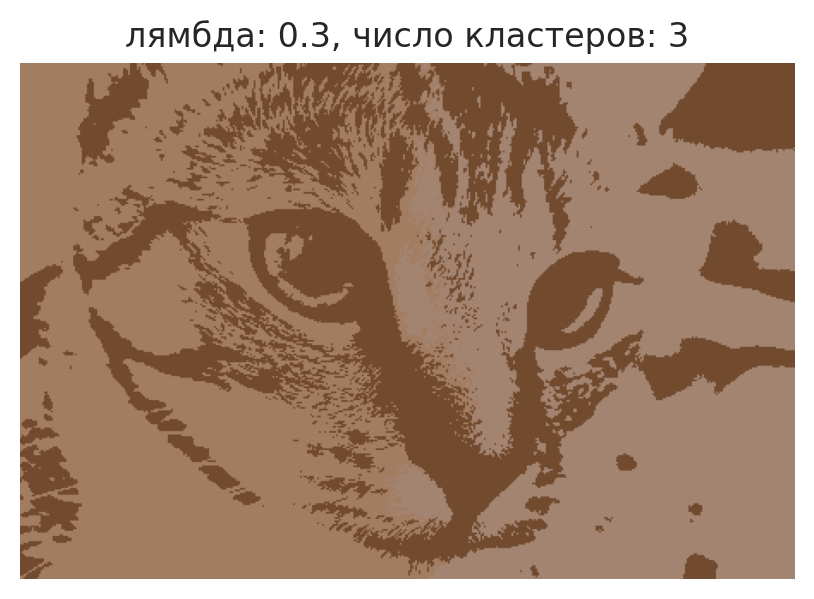

In [ ]:
img = img_kitten
n_clusters = 3
lambda_value = 0.3

segmented_image = find_components(img, lambda_value, n_clusters)

plt.figure(figsize=(5, 5))
plt.imshow(segmented_image)
plt.title(f"лямбда: {lambda_value}, число кластеров: {n_clusters}")
plt.axis("off")
plt.show()